In [1]:
!pip install requests beautifulsoup4 spacy networkx
!python -m spacy download en_core_web_sm

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 12.8/12.8 MB 83.6 MB/s eta 0:00:0000:0100:01
✔ Download and installation successful
You can now load the package via spacy.load('en_core_web_sm')


In [2]:
import requests
from bs4 import BeautifulSoup
import pandas as pd 
import spacy
import networkx as nx

In [6]:
def scrape(topic_url, default_url, attrs, attrs_val):
    response = requests.get(topic_url)
    soup = BeautifulSoup(response.text, 'html.parser')

    links = soup.find_all('a', href=True)
    
    article_links = []
    for link in links:
        child_div = link.find('div', {attrs : attrs_val})
        if child_div:
            article_links.append(default_url + link['href'])

    return article_links

In [7]:
bbc_indonesia_url = 'https://www.bbc.com/news/topics/cmj34zmw7vmt'
bbc_default_url = "https://www.bbc.com"
links_common_attrs = "data-testid" # All links have this attribute
links_common_attrs_val = "liverpool-article" #attribute's value
links = scrape(bbc_indonesia_url, bbc_default_url, links_common_attrs, links_common_attrs_val)
print(links)

['https://www.bbc.com/news/articles/c3wp8ndnv9qo', 'https://www.bbc.com/news/articles/c5ylzy7drzqo', 'https://www.bbc.com/news/articles/cm2npr4pg5no', 'https://www.bbc.com/news/articles/c8er13zy1gxo', 'https://www.bbc.com/news/articles/c23lmnn230lo', 'https://www.bbc.com/news/articles/cm233yjj42xo', 'https://www.bbc.com/news/articles/cd19xnxdvlko', 'https://www.bbc.com/news/articles/cz473vr2qvro']


In [8]:
def fetch_article_content(link, paragraph_class):
    response = requests.get(link)
    soup = BeautifulSoup(response.text, 'html.parser')
    
    paragraphs = soup.find_all(class_= paragraph_class)

    article_text = ' '.join([para.get_text() for para in paragraphs])
    
    return article_text

In [13]:
articles = []
paragraph_class = "sc-eb7bd5f6-0 fYAfXe"
for link in links:
    content = fetch_article_content(link, paragraph_class)
    articles.append(content)
print(articles)

['A New Zealand pilot who has been freed more than 19 months after being taken hostage by separatists in Indonesia says he is "very happy" to be going home to his family. Philip Mehrtens was kidnapped by West Papua National Liberation Army fighters in February 2023 and was released after lengthy negotiations into the care of Indonesian officials on Saturday.  He appeared before cameras looking thin and with a full beard but is said to be in good health.  The 38-year-old was kidnapped after he landed a small commercial plane in the remote, mountainous area of Nduga. "Today I have been freed. I am very happy that shortly I will be able to go home and meet my family," Mr Mehrtens, speaking in Indonesian, told reporters in Timika. "Thank you for everybody who helped me today, so I can get out safely in a healthy condition." His release follows months of "critical" diplomatic efforts by authorities in Wellington and Jakarta. New Zealand Prime Minister Christopher Luxon welcomed the release 

In [14]:
nlp = spacy.load("en_core_web_sm") 

In [15]:
def extract_entities(article):
    article = nlp(article)
    entities = {}
    for ent in article.ents:
        entities[ent.text] = ent.label_
    return entities

In [17]:
entities_list = []
for article in articles:
    entities = extract_entities(article)
    entities_list.append(entities)
print(entities_list)

[{'New Zealand': 'GPE', 'more than 19 months': 'DATE', 'Indonesia': 'GPE', 'Philip Mehrtens': 'PERSON', 'West Papua National Liberation Army': 'ORG', 'February 2023': 'DATE', 'Indonesian': 'NORP', 'Saturday': 'DATE', '38-year-old': 'DATE', 'Nduga': 'ORG', 'Mehrtens': 'PERSON', 'Timika': 'LOC', 'today': 'DATE', 'months': 'DATE', 'Wellington': 'GPE', 'Jakarta': 'GPE', 'Christopher Luxon': 'PERSON', 'Winston Peters': 'PERSON', 'Bayu Suseno': 'PERSON', 'Yuguru': 'LOC', 'Several days': 'DATE', 'BBC': 'ORG', 'Sebby Sambom': 'PERSON', 'Susi Air - landed': 'ORG', 'February last year': 'DATE', 'a few hours later': 'TIME', 'five': 'CARDINAL', 'Papuans': 'NORP', "West Papua's": 'NORP', 'April': 'DATE', 'at least one': 'CARDINAL', 'Papua': 'PERSON', 'Last month': 'DATE', '50-year-old': 'DATE', 'Glen Malcolm Conning': 'PERSON', 'Free Papua Organisation': 'ORG', 'two': 'CARDINAL', "Mr Conning's": 'ORG', 'the West Papua National Liberation Army': 'ORG', 'Australia': 'GPE', 'Joko Widodo': 'PERSON', 'D

In [19]:
df = pd.DataFrame({
    'Article': articles,
    'Entities': entities_list
})

In [20]:
df.head()

,Article,Entities
0,A New Zealand pilot who has been freed more th...,"{'New Zealand': 'GPE', 'more than 19 months': ..."
1,Pope Francis has warned against using religion...,"{'Pope Francis': 'PERSON', 'last day': 'DATE',..."
2,Pope Francis has arrived in the Indonesian cap...,"{'Pope Francis': 'PERSON', 'Indonesian': 'NORP..."
3,Police clashed with protesters in the Indonesi...,"{'Indonesian': 'NORP', 'Jakarta': 'GPE', 'tens..."
4,Indonesia has celebrated Independence Day in i...,"{'Indonesia': 'GPE', 'Independence Day': 'EVEN..."


In [26]:
G = nx.Graph()

for index, row in df.iterrows():
    entities = row['Entities']
    entity_list = list(entities.keys())
    for i in range(len(entity_list)):
        for j in range(i + 1, len(entity_list)):
            G.add_edge(entity_list[i], entity_list[j])
            
degrees = dict(G.degree())

In [27]:
print(f"Number of nodes: {G.number_of_nodes()}")
print(f"Number of edges: {G.number_of_edges()}")

Number of nodes: 255
Number of edges: 7919


In [28]:
num_nodes_to_keep = max(1, int(len(degrees) * 0.8)) 

filtered_nodes = sorted(degrees, key=degrees.get, reverse=True)[:num_nodes_to_keep]

filtered_graph = G.subgraph(filtered_nodes)

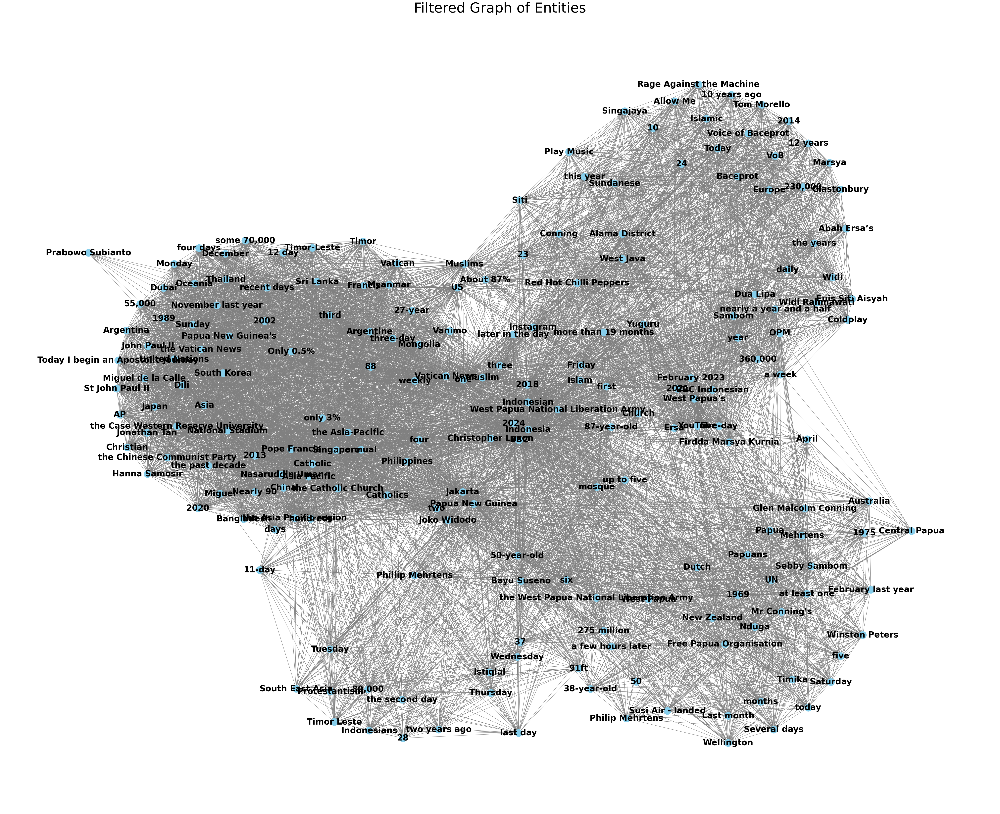

In [30]:
import matplotlib.pyplot as plt

plt.figure(figsize=(50, 40))

pos = nx.spring_layout(filtered_graph, k=1.2)
nx.draw(filtered_graph, pos, with_labels=True, node_size=700, node_color='skyblue', font_size=30, font_weight='bold', edge_color='gray')

plt.title("Filtered Graph of Entities", fontsize=50)
plt.show()